In [1]:
# Notebook https://www.kaggle.com/code/algord/abstract-art-generator-dcgan/notebook
import os 

cwd = os.path.dirname(os.path.realpath('__file__'))
inputs = cwd + "/inputs/"
if not os.path.isdir(inputs):
    os.mkdir(inputs)
outputs = cwd + "/outputs/"
if not os.path.isdir(outputs):
    os.mkdir(outputs)

dcgan_wd = inputs + "Abstract_gallery/"
inf = [f for f in os.listdir(dcgan_wd)]
print(inf)

if inf == []:
    raise FileNotFoundError("Data is not extracted in the inputs directory! Extract the data DCGAN/abstract-art-gallery.zip to inputs directory (e.g. tar -xvf abstract-art-gallery.zip -C inputs)!")

['Abstract_gallery']


In [2]:
# In case dataset is not downloaded at all = DCGAN/abstract-art-gallery.zip not present
# do the following:
#
# Install kaggle (pip3 or pip)
# pip3 install kaggle
#
# Download dataset to the workdir of Sentiment-IMDB
# kaggle datasets download bryanb/abstract-art-gallery
#
# Untar downloaded dataset to inputs dir
# tar -xvf abstract-art-gallery.zip -C inputs

In [3]:
import os
import numpy as np
import torch
import torchvision.transforms as transforms
from torchvision.utils import make_grid
from torch import nn, optim
from matplotlib import pyplot as plt
import seaborn as sns

In [4]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cpu


In [5]:
print(dcgan_wd)

/Users/astralmiau/cmu/acaisdk/acaisdk/example/DCGAN/inputs/Abstract_gallery/


In [6]:
norm=((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
batch_size = 64
image_size = 64

In [7]:
transf = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize(*norm,inplace=True),
])

In [8]:
from torchvision import datasets

dataset = datasets.ImageFolder(root=dcgan_wd,transform=transf)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)

In [9]:
def unnorm(images, means, stds):
    means = torch.tensor(means).reshape(1,3,1,1)
    stds = torch.tensor(stds).reshape(1,3,1,1)
    return images*stds+means

In [10]:
def show_batch(data_loader):
    for images, labels in data_loader:
        fig, ax = plt.subplots(figsize=(15, 15))
        ax.set_xticks([]); ax.set_yticks([])
        unnorm_images = unnorm(images, *norm)
        ax.imshow(make_grid(unnorm_images[:batch_size], nrow=8).permute(1, 2, 0).clamp(0,1))
        break

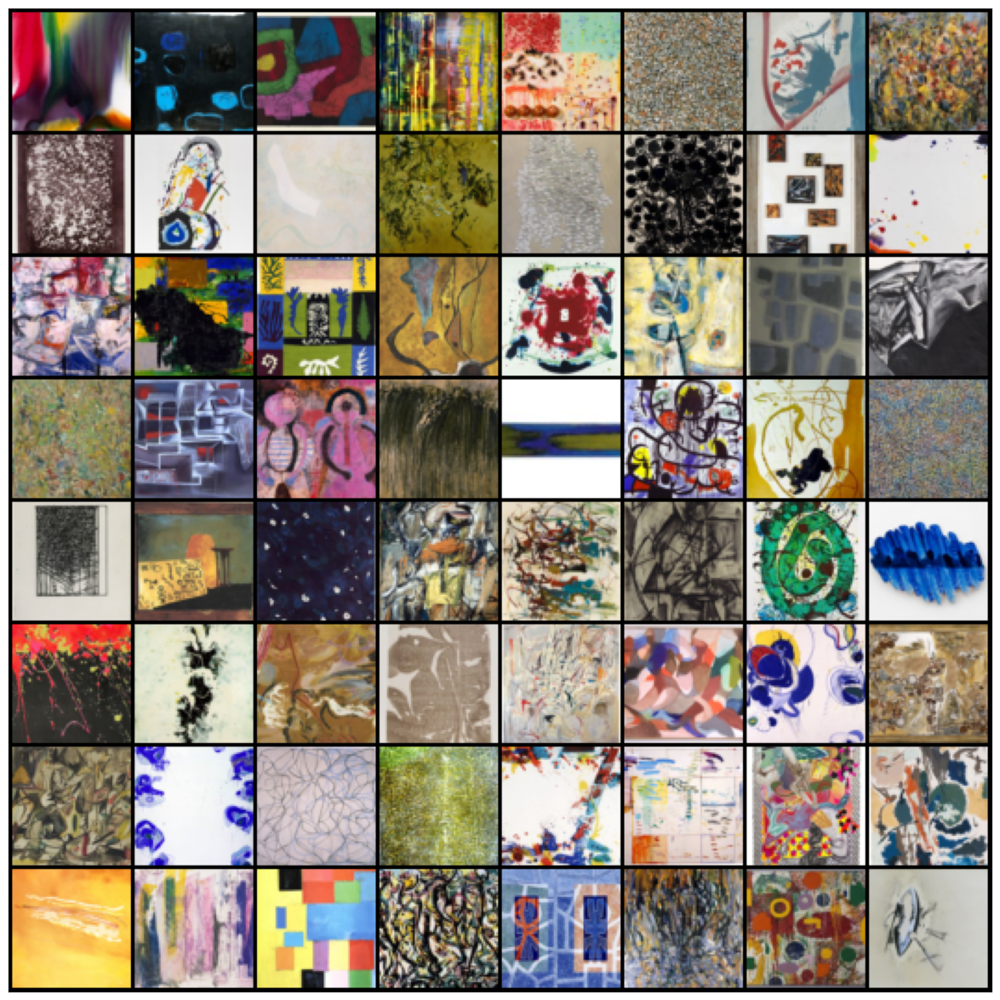

In [11]:
show_batch(dataloader)


In [12]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [13]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(100, 64 * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(64 * 8, 64 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(64 * 4, 64 * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(64 * 2, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

modelG = Generator()
modelG.to(device)
modelG.apply(weights_init)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

In [14]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 64 * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64 * 2, 64 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64 * 4, 64 * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64 * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)
    
modelD = Discriminator()
modelD.to(device)
modelD.apply(weights_init)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [15]:
criterion = nn.BCELoss()
fixed_noise = torch.randn(64, 100, 1, 1, device=device)

real_label = 1.
fake_label = 0.

optimizerD = optim.Adam(modelD.parameters(), lr=0.0001, betas=(0.5, 0.999))
optimizerG = optim.Adam(modelG.parameters(), lr=0.0001, betas=(0.5, 0.999))

In [16]:
%%time
import torchvision.utils as vutils

img_list = []
G_losses, D_losses = [], []
total = 0

for epoch in range(200):
    g_loss = 0.0
    d_loss = 0.0
    D_x = 0.0
    D_G_z1 = 0.0
    D_G_z2 = 0.0
    
    for i, data in enumerate(dataloader, 0):
        
        modelD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = modelD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x += output.mean().item()
        noise = torch.randn(b_size, 100, 1, 1, device=device)
        fake = modelG(noise)
        label.fill_(fake_label)
        output = modelD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 += output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        modelG.zero_grad()
        label.fill_(real_label)
        output = modelD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 += output.mean().item()
        optimizerG.step()
        
        g_loss += errG.item()
        d_loss += errD.item()
        total += b_size
        
    avg_g_loss = g_loss / total
    G_losses.append(avg_g_loss)
    avg_d_loss = d_loss / total
    D_losses.append(avg_d_loss)
    
    avg_D_x = D_x / len(dataloader)
    avg_D_G_z1 = D_G_z1 / len(dataloader)
    avg_D_G_z2 = D_G_z2 / len(dataloader)
    
    print('Epoch: {} \tDiscriminator Loss: {:.6f} \tGenerator Loss: {:.6f} \tD(x): {:.6f} \tD(G(z)): {:.6f} / {:.6f}'.format(
        epoch + 1,
        avg_d_loss,
        avg_g_loss,
        avg_D_x,
        avg_D_G_z1,
        avg_D_G_z2
    ))
    
    with torch.no_grad():
        fake = modelG(fixed_noise).detach().cpu()
    img_list.append(vutils.make_grid(unnorm(fake, *norm), padding=2, normalize=True))
    
print('Finished Training')

Epoch: 1 	Discriminator Loss: 0.007872 	Generator Loss: 0.085609 	D(x): 0.825737 	D(G(z)): 0.200838 / 0.014560
Epoch: 2 	Discriminator Loss: 0.001161 	Generator Loss: 0.070448 	D(x): 0.941858 	D(G(z)): 0.068722 / 0.000745
Epoch: 3 	Discriminator Loss: 0.000619 	Generator Loss: 0.057059 	D(x): 0.955055 	D(G(z)): 0.043670 / 0.000754
Epoch: 4 	Discriminator Loss: 0.000547 	Generator Loss: 0.049312 	D(x): 0.955037 	D(G(z)): 0.050123 / 0.000763
Epoch: 5 	Discriminator Loss: 0.001549 	Generator Loss: 0.021471 	D(x): 0.847265 	D(G(z)): 0.139003 / 0.014348
Epoch: 6 	Discriminator Loss: 0.000748 	Generator Loss: 0.016096 	D(x): 0.897658 	D(G(z)): 0.102634 / 0.007155
Epoch: 7 	Discriminator Loss: 0.000246 	Generator Loss: 0.014695 	D(x): 0.951564 	D(G(z)): 0.046330 / 0.002426
Epoch: 8 	Discriminator Loss: 0.000240 	Generator Loss: 0.013782 	D(x): 0.946274 	D(G(z)): 0.045975 / 0.002746
Epoch: 9 	Discriminator Loss: 0.000190 	Generator Loss: 0.012006 	D(x): 0.957391 	D(G(z)): 0.040321 / 0.002832
E

Epoch: 75 	Discriminator Loss: 0.000074 	Generator Loss: 0.000841 	D(x): 0.864082 	D(G(z)): 0.138584 / 0.052293
Epoch: 76 	Discriminator Loss: 0.000108 	Generator Loss: 0.000877 	D(x): 0.832188 	D(G(z)): 0.160090 / 0.079449
Epoch: 77 	Discriminator Loss: 0.000062 	Generator Loss: 0.000831 	D(x): 0.876791 	D(G(z)): 0.121574 / 0.041050
Epoch: 78 	Discriminator Loss: 0.000071 	Generator Loss: 0.000827 	D(x): 0.860510 	D(G(z)): 0.135408 / 0.045001
Epoch: 79 	Discriminator Loss: 0.000061 	Generator Loss: 0.000838 	D(x): 0.880339 	D(G(z)): 0.121252 / 0.042634
Epoch: 80 	Discriminator Loss: 0.000068 	Generator Loss: 0.000896 	D(x): 0.867828 	D(G(z)): 0.129439 / 0.033954
Epoch: 81 	Discriminator Loss: 0.000132 	Generator Loss: 0.000897 	D(x): 0.800659 	D(G(z)): 0.193823 / 0.078786
Epoch: 82 	Discriminator Loss: 0.000057 	Generator Loss: 0.000750 	D(x): 0.877821 	D(G(z)): 0.123708 / 0.040166
Epoch: 83 	Discriminator Loss: 0.000053 	Generator Loss: 0.000793 	D(x): 0.886337 	D(G(z)): 0.112448 / 0

Epoch: 148 	Discriminator Loss: 0.000082 	Generator Loss: 0.000579 	D(x): 0.830221 	D(G(z)): 0.166275 / 0.096293
Epoch: 149 	Discriminator Loss: 0.000025 	Generator Loss: 0.000457 	D(x): 0.904507 	D(G(z)): 0.092623 / 0.043304
Epoch: 150 	Discriminator Loss: 0.000022 	Generator Loss: 0.000467 	D(x): 0.920859 	D(G(z)): 0.085246 / 0.031351
Epoch: 151 	Discriminator Loss: 0.000015 	Generator Loss: 0.000457 	D(x): 0.933711 	D(G(z)): 0.063993 / 0.028505
Epoch: 152 	Discriminator Loss: 0.000027 	Generator Loss: 0.000464 	D(x): 0.905371 	D(G(z)): 0.088342 / 0.055572
Epoch: 153 	Discriminator Loss: 0.000058 	Generator Loss: 0.000465 	D(x): 0.855621 	D(G(z)): 0.151035 / 0.065788
Epoch: 154 	Discriminator Loss: 0.000019 	Generator Loss: 0.000431 	D(x): 0.919780 	D(G(z)): 0.080694 / 0.031413
Epoch: 155 	Discriminator Loss: 0.000020 	Generator Loss: 0.000425 	D(x): 0.918038 	D(G(z)): 0.078126 / 0.041304
Epoch: 156 	Discriminator Loss: 0.000014 	Generator Loss: 0.000432 	D(x): 0.937098 	D(G(z)): 0.0

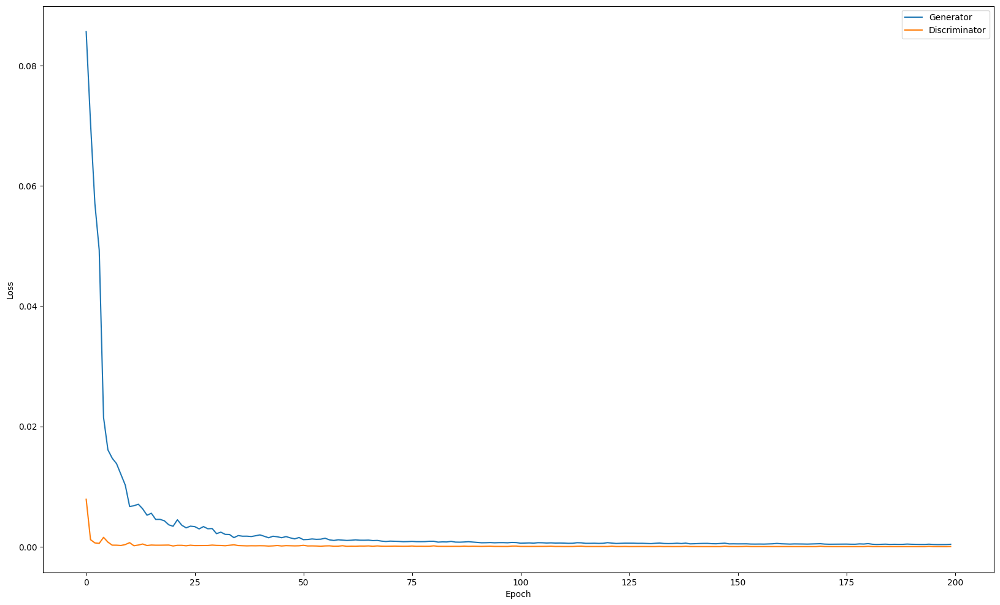

In [17]:
plt.figure(figsize=(20,12))
plt.plot(G_losses,label="Generator")
plt.plot(D_losses,label="Discriminator")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21112901 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


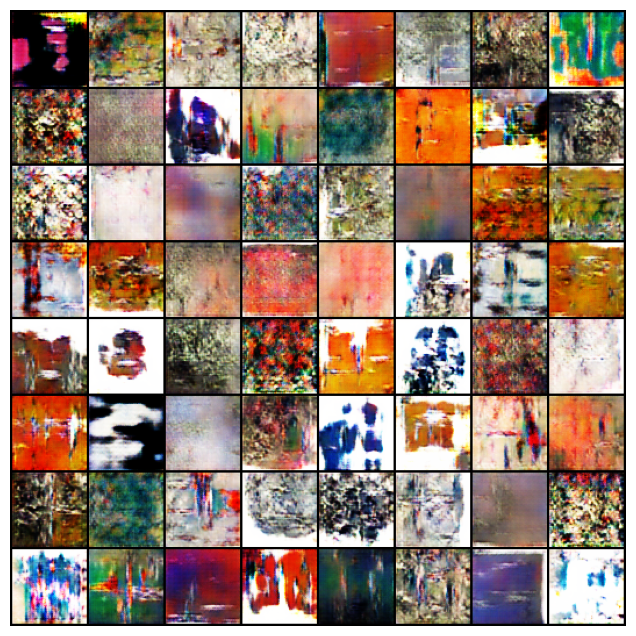

In [18]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list[::6]]
ani = animation.ArtistAnimation(fig, ims, interval=250, repeat_delay=250, blit=True)

HTML(ani.to_jshtml())